# Plot embeddings of cell type annotations in large PBMC panel

In [46]:
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import datetime
import pytometry as pm


sc.logging.print_versions()
sc.settings.verbosity = 3 

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.8.0
scanpy      1.8.1
sinfo       0.3.4
-----
2f7ece400a652629565c523b34ee61b04afa385c    NA
Cython                                      0.29.24
PIL                                         8.4.0
absl                                        NA
anyio                                       NA
asciitree                                   NA
astunparse                                  1.6.3
attr                                        21.2.0
babel                                       2.9.1
backcall

In [2]:
sc.settings.figdir = './../figures/' 

Add date.

In [3]:
now = datetime.datetime.now()
today = now.strftime("%Y%m%d")

In [4]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 80))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,10))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

Set parameters for vector friendly figures.

In [34]:
sc.set_figure_params(vector_friendly=True, dpi_save=150)

# Introduction

In this notebook, we pre-process flow data of healthy human donors from a previously conducted study (Knoll et al. 2023) using a 27-marker panel on PBMCs by the Aschenbrenner group at DZNE Bonn (Germany). 
We employ the following steps:
1. Load and convert fcs file into anndata format
2. Compensate for channel bleedthrough
3. Bi-exponential normalisation
4. Subset to consensus labeling computed by all experts
5. Compute knn-graph
6. Compute UMAP

In [5]:
import os
import re

In [6]:
data_path = './../data/Convex_gating_test_MB/'

# Read files and preprocess data

Fetch all `fcs` files.

In [10]:
files_all = os.listdir(data_path)

In [11]:
files = [fileID for fileID in files_all if fileID.endswith('.fcs')]

In [13]:
adatas = []
for fileID in np.unique(files[5:]): 
    print(fileID)
    meta_info = fileID.split('.fcs')[0].split('_')[-1]
        
    adata = pm.io.read_fcs(data_path  + fileID)
    adata.obs['sample'] = meta_info

    #run compensation
    pm.pp.compensate(adata)
    
    #move Time, FSC, SSC to obs
    pm.pp.split_signal(adata, var_key='channel')
    
    adatas.append(adata)

190411_HFGP2000 pilot_NL01.fcs
190411_HFGP2000 pilot_NL03.fcs
190411_HFGP2000 pilot_NL05.fcs
190411_HFGP2000 pilot_NL07.fcs
190411_HFGP2000 pilot_NL09.fcs


Concatenate data.

In [14]:
adata_all = ann.AnnData.concatenate(*adatas, join = 'outer', uns_merge = 'unique')

/home/buettnerm/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [15]:
adata_all

AnnData object with n_obs × n_vars = 1444540 × 27
    obs: 'sample', 'FSC-A', 'FSC-H', 'FSC-W', 'SSC-A', 'SSC-H', 'SSC-W', 'Time', 'batch'
    var: 'channel', 'marker', 'signal_type'
    uns: 'meta'
    layers: 'original'

## Normalize data

Add compensated data to file.

In [17]:
adata_all.layers['compensated'] = adata_all.X

Load parameters for biexponential normalization from file. 

In [18]:
files_params = [fileID for fileID in files_all if fileID.count('_params_')>0]

In [19]:
adata_all.obs['sample'] = adata_all.obs['sample'].astype('category')

In [20]:
meta_info = adata_all.obs['sample'].cat.categories.values

Read params from FlowJo file and match names.

In [21]:
adatas = []
for metaID in meta_info:
    fileID = [file for file in files_params if file.count(metaID)][0]
    params = pd.read_csv(data_path + fileID, 
                     index_col = 0)
    rename_col = [idx.split('parameters.')[-1] for idx in params.columns.values]
    params.columns = rename_col
    #use only area params
    params = params.loc[[channel.endswith('-A') for channel in params.index]]
    #rename index using the adata.var['channel'] info
    tmp_var = adata_all.var
    adata_all.var['channel_tmp'] = [channel.replace('/', '_') for channel in tmp_var.channel]
    channel_renames = dict(zip(tmp_var['channel_tmp'].values, 
                           tmp_var['marker'].values))
    params.index = params.index.map(channel_renames)
    #match channels
    tmp_var = pd.merge(tmp_var, params, left_index=True, right_index=True)
    
    #run normalization per sample
    adata_tmp = pm.tl.normalize_biExp(adata = adata_all[adata_all.obs['sample']==metaID].copy(), 
                                      negative = tmp_var['neg'], 
                                      positive = tmp_var['pos'], 
                                      width = tmp_var['widthBasis'],
                                      max_value = tmp_var['maxValue'],
                                      inplace=False
                                     )
    adatas.append(adata_tmp)

Concatenate data.

In [22]:
adata_filt = ann.AnnData.concatenate(*adatas, join = 'outer', uns_merge = 'unique')

In [23]:
adata_filt

AnnData object with n_obs × n_vars = 1444540 × 27
    obs: 'sample', 'FSC-A', 'FSC-H', 'FSC-W', 'SSC-A', 'SSC-H', 'SSC-W', 'Time', 'batch'
    var: 'channel', 'marker', 'signal_type', 'channel_tmp'
    uns: 'meta'
    layers: 'original', 'compensated'

Use first concatenation index.

In [24]:
adata_filt.obs_names = adata_all.obs_names

In [25]:
adata_filt

AnnData object with n_obs × n_vars = 1444540 × 27
    obs: 'sample', 'FSC-A', 'FSC-H', 'FSC-W', 'SSC-A', 'SSC-H', 'SSC-W', 'Time', 'batch'
    var: 'channel', 'marker', 'signal_type', 'channel_tmp'
    uns: 'meta'
    layers: 'original', 'compensated'

## Subset to consensus labels

In [8]:
dfi0 = pd.read_csv(f'../table/20250227_unscaledISI_level1.csv', index_col=0)

In [9]:
dfi2 = pd.read_csv(f'../table/20250227_unscaledISI_level2.csv', index_col=0)

Here we use the consensus label to visualize the data in a UMAP. For this purpose, we subset to the annotated cells in the consensus label computed above. 

In [26]:
adata_filt.obs['consensus label lvl 1'] = dfi0['consensus label']
adata_filt.obs['consensus label lvl 2'] = dfi2['consensus label']
#add ISI for visualization purposes
adata_filt.obs['ISI lvl 1'] = dfi0['ISI']
adata_filt.obs['ISI lvl 2'] = dfi2['ISI']

In [27]:
adata_sub = adata_filt[adata_filt.obs['consensus label lvl 1']!='not annotated'].copy()

In [28]:
adata_sub

AnnData object with n_obs × n_vars = 1205984 × 27
    obs: 'sample', 'FSC-A', 'FSC-H', 'FSC-W', 'SSC-A', 'SSC-H', 'SSC-W', 'Time', 'batch', 'consensus label lvl 1', 'consensus label lvl 2', 'ISI lvl 1', 'ISI lvl 2'
    var: 'channel', 'marker', 'signal_type', 'channel_tmp'
    uns: 'meta'
    layers: 'original', 'compensated'

Create a second subset where cells are annotated in either lvl 1 or lvl 2.

In [29]:
adata_sub2 = adata_filt[np.logical_or(adata_filt.obs['consensus label lvl 1']!='not annotated', 
                                      adata_filt.obs['consensus label lvl 2']!='not annotated'
                                     )].copy()

In [30]:
adata_sub2

AnnData object with n_obs × n_vars = 1206615 × 27
    obs: 'sample', 'FSC-A', 'FSC-H', 'FSC-W', 'SSC-A', 'SSC-H', 'SSC-W', 'Time', 'batch', 'consensus label lvl 1', 'consensus label lvl 2', 'ISI lvl 1', 'ISI lvl 2'
    var: 'channel', 'marker', 'signal_type', 'channel_tmp'
    uns: 'meta'
    layers: 'original', 'compensated'

# Compute embeddding

In [31]:
sc.pp.pca(adata_sub)
sc.pp.neighbors(adata_sub, n_neighbors = 15, n_pcs=10)
sc.tl.umap(adata_sub)

computing PCA
    with n_comps=26
    finished (0:00:03)
computing neighbors
    using data matrix X directly


2025-02-27 17:50:28.333062: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/R/lib/R/lib::/.singularity.d/libs
2025-02-27 17:50:28.333127: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:04:39)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:34:11)


## Plot UMAPs

In [32]:
adata_sub.obs['consensus label lvl 1'] = adata_sub.obs['consensus label lvl 1'].astype('category')
adata_sub.obs['consensus label lvl 1'] = adata_sub.obs['consensus label lvl 1'].cat.reorder_categories(
['B cell','T cell', 'NK cell',  'Monocyte', 'Dendritic cell'])

In [33]:
adata_sub.obs['consensus label lvl 2'] = adata_sub.obs['consensus label lvl 2'].astype('category')
adata_sub.obs['consensus label lvl 2'] = adata_sub.obs['consensus label lvl 2'].cat.reorder_categories(
['B cell','T cell', 'NK cell',  'Monocyte', 'Dendritic cell', 'CD4+ T cell', 'CD8+ T cell', 'NKT cell', 
 'Classical monocyte',
       'Intermediate monocyte','Non-classical monocyte', 
         'cDC', 'pDC',  
 'not annotated'])

... storing 'sample' as categorical


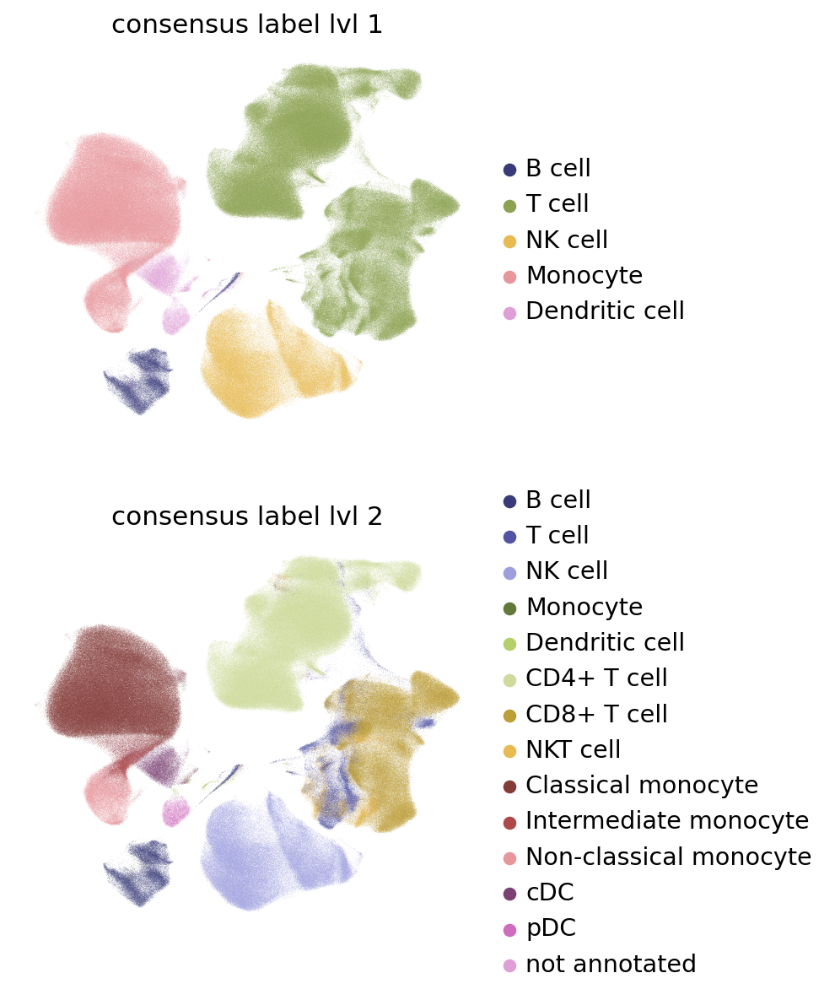

In [35]:
sc.pl.umap(adata_sub, 
           color=['consensus label lvl 1', 
                  'consensus label lvl 2', 
                  ],  ncols=1, frameon=False, palette='tab20b')

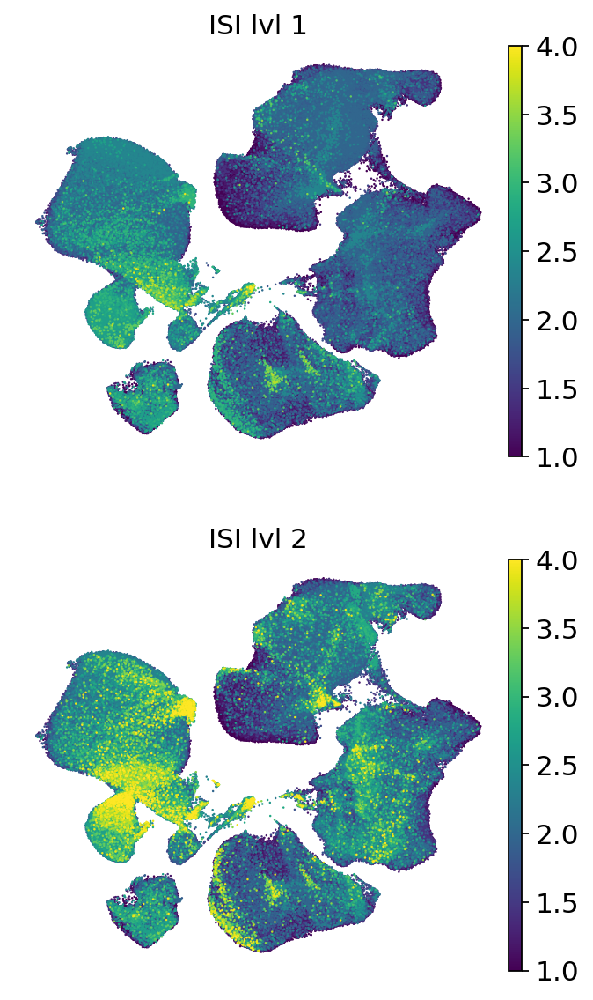

In [36]:
sc.pl.umap(adata_sub, 
           color=[ 'ISI lvl 1', 
                   'ISI lvl 2'], 
           legend_loc=None, size=5, ncols=1, frameon=False, vmax=4)

In [37]:
sc.pp.pca(adata_sub2)
sc.pp.neighbors(adata_sub2, n_neighbors = 15, n_pcs=10)
sc.tl.umap(adata_sub2)

computing PCA
    with n_comps=26
    finished (0:00:02)
computing neighbors
    using data matrix X directly
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:04:38)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:38:39)


In [38]:
adata_sub2.obs['consensus label lvl 1'] = adata_sub2.obs['consensus label lvl 1'].astype('category')
adata_sub2.obs['consensus label lvl 1'] = adata_sub2.obs['consensus label lvl 1'].cat.reorder_categories(
['B cell','T cell', 'NK cell',  'Monocyte', 'Dendritic cell', 'not annotated'])

In [39]:
adata_sub2.obs['consensus label lvl 2'] = adata_sub2.obs['consensus label lvl 2'].astype('category')
adata_sub2.obs['consensus label lvl 2'] = adata_sub2.obs['consensus label lvl 2'].cat.reorder_categories(
['B cell','T cell', 'NK cell',  'Monocyte', 'Dendritic cell', 'CD4+ T cell', 'CD8+ T cell', 'NKT cell', 
 'Classical monocyte', 'Intermediate monocyte','Non-classical monocyte', 
 'cDC', 'pDC',  
 'not annotated'])

In [40]:
adata_sub2.uns['consensus label lvl 1_colors'] = ['#c49c94', #B
                                                  '#1f77b4', #T
                                                  '#ff7f0e', #NK
                                                  '#98df8a', #Mono
                                                  '#2ca02c', #DC
                                                  '#aaaaaa' #NA
                                                 ]                                                 

In [41]:
adata_sub2.uns['consensus label lvl 2_colors'] = ['#c49c94', #B
                                                  '#1f77b4', #T
                                                  '#ff7f0e', #NK
                                                  '#98df8a', #Mono
                                                  '#2ca02c', #DC
                                                  '#aec7e8', #CD4
                                                  '#9edae5', #CD8                                           
                                                  '#8c564b', #NKT
                                                  '#dbdb8d', #C Mono
                                                  '#9467bd', #I Mono
                                                  '#e377c2', #NC Mono
                                                  '#7f7f7f', #cDC
                                                  '#ff9896', #pDC
                                                  '#aaaaaa' #NA
                                                 ]

In [7]:
#adata_sub2 = sc.read(data_path + 'anndata/' + 'HIV_data_norm_manGates2.h5ad')

... storing 'sample' as categorical


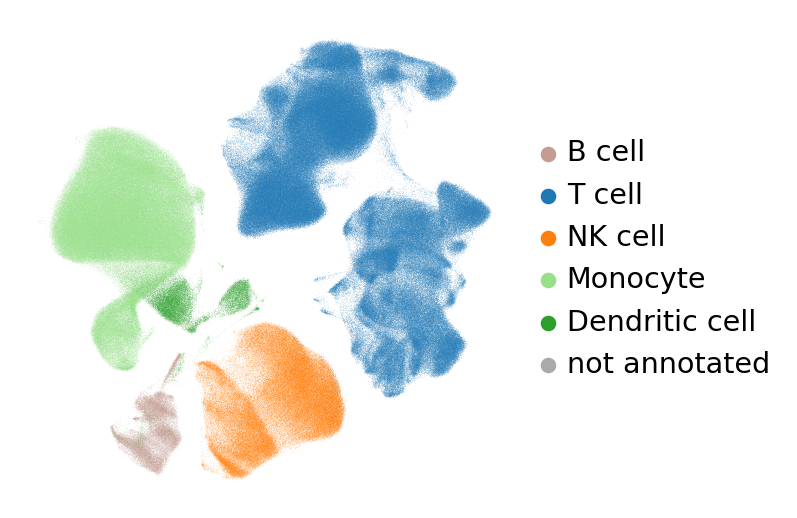

In [42]:
sc.pl.umap(adata_sub2, 
           color=[  'consensus label lvl 1' ], 
           ncols=1, frameon=False, 
           title='',
           save=f'{today}_consensus_labels_lvl1.pdf'
          )

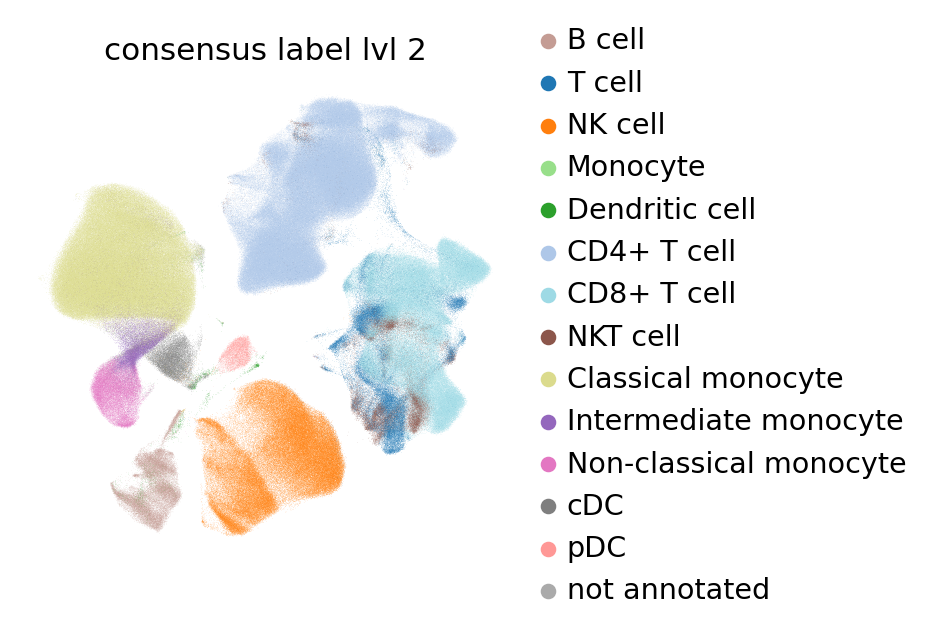

In [43]:
sc.pl.umap(adata_sub2, 
           color=[ 
                  'consensus label lvl 2', 
                  ], 
           ncols=1, frameon=False, 
           save=f'{today}_consensus_labels_lvl2.pdf'
          )

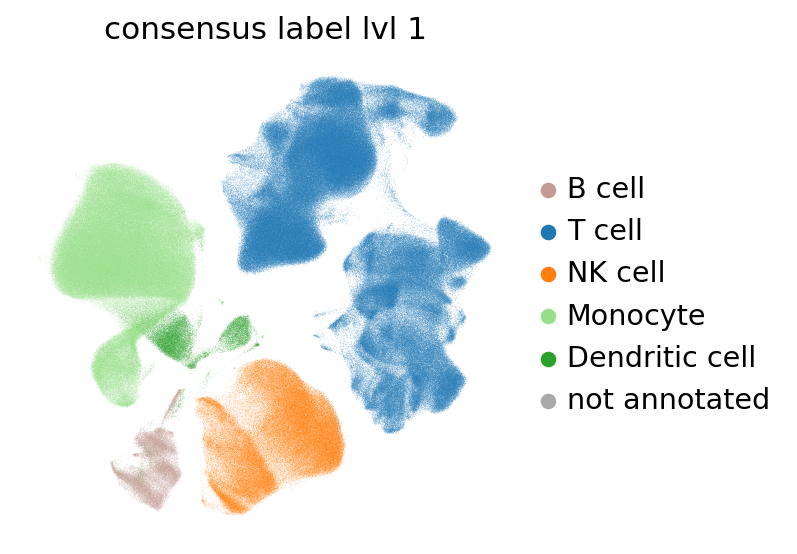

In [44]:
sc.pl.umap(adata_sub2, 
           color=[  'consensus label lvl 1', 
                   
                  ],  
           ncols=1, frameon=False, 
           save=f'{today}_consensus_labels_lvl1.png'
          )

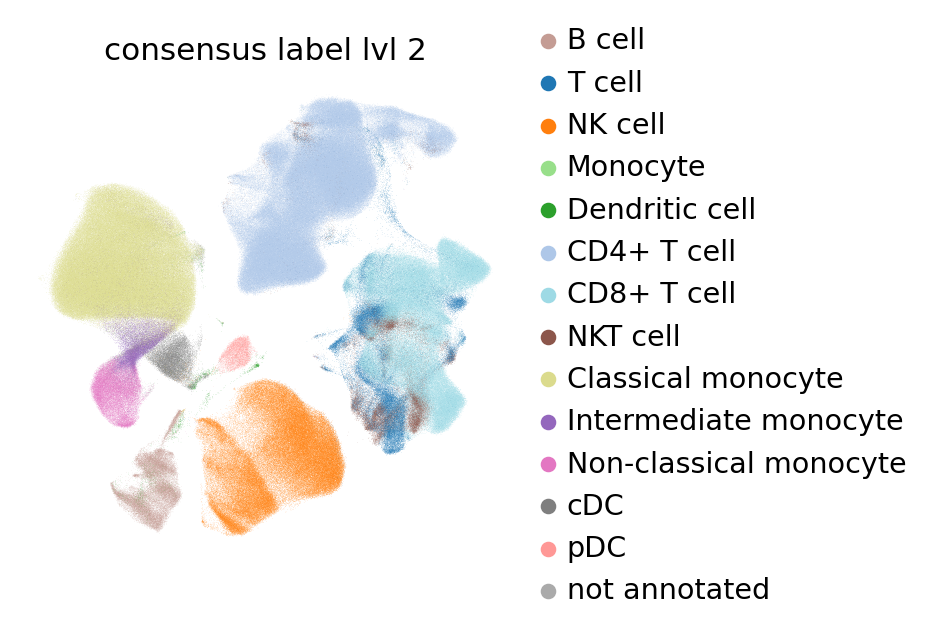

In [47]:
sc.pl.umap(adata_sub2, 
           color=[ 
                  'consensus label lvl 2', 
                  ],  
           ncols=1, frameon=False, 
           save=f'{today}_consensus_labels_lvl2.png'
          )

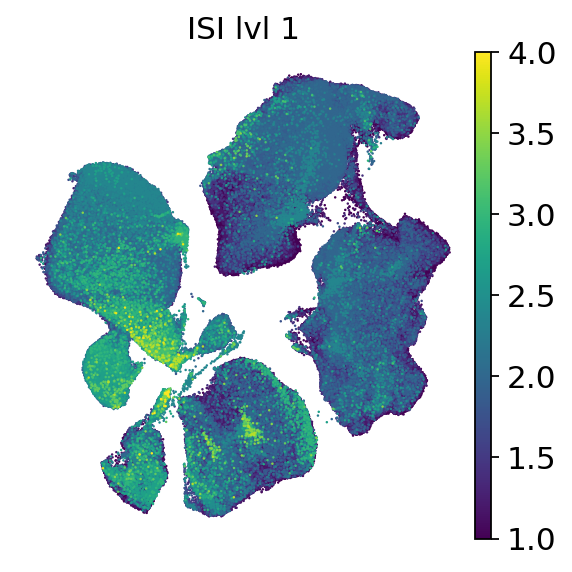

In [48]:
sc.pl.umap(adata_sub2, 
           color=[  'ISI lvl 1', 
                   ], 
           legend_loc=None, size=5, ncols=1, frameon=False, vmax=4,
           save=f'{today}_unscaled_ISI_lvl1.png'
          )

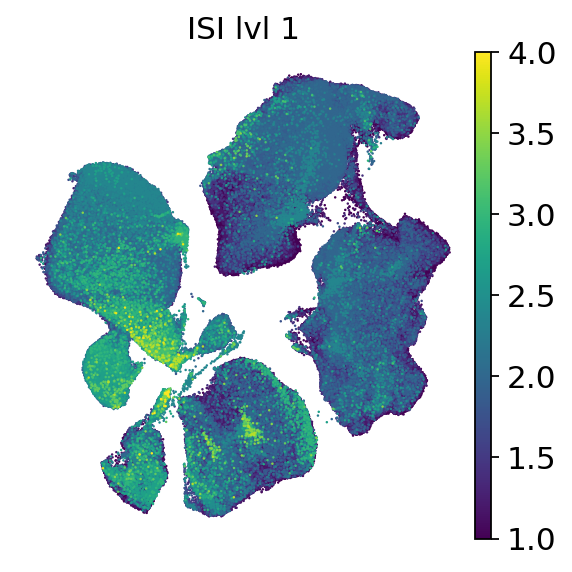

In [49]:
sc.pl.umap(adata_sub2, 
           color=[  'ISI lvl 1', 
                   ], legend_loc=None, size=5, ncols=1, frameon=False, vmax=4,
           save=f'{today}_unscaled_ISI_lvl1.pdf'
          )

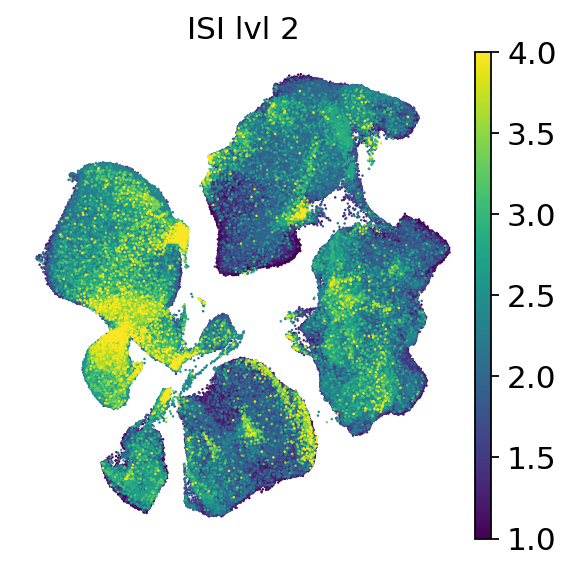

In [50]:
sc.pl.umap(adata_sub2, 
           color=[  
                   'ISI lvl 2'], legend_loc=None, size=5, ncols=1, frameon=False, vmax=4,
           save=f'{today}_unscaled_ISI_lvl2.png'
          )

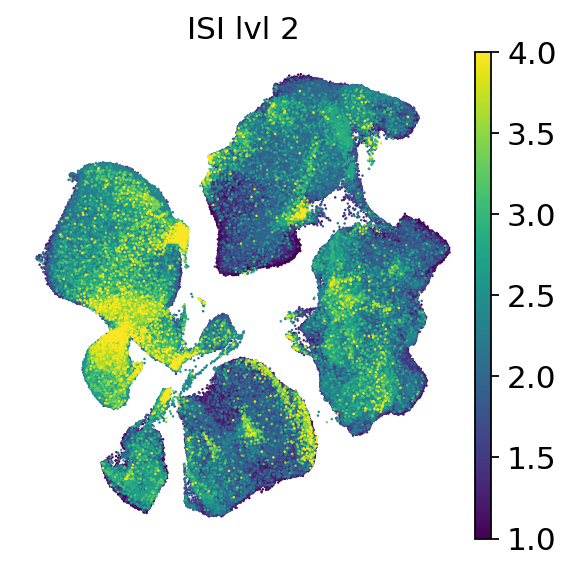

In [51]:
sc.pl.umap(adata_sub2, 
           color=[  
                   'ISI lvl 2'], legend_loc=None, size=5, ncols=1, frameon=False, vmax=4,
           save=f'{today}_unscaled_ISI_lvl2.pdf'
          )

In [52]:
adata_sub.write(data_path + 'anndata/' + 'HIV_data_norm_manGates_final.h5ad')

In [53]:
adata_sub2.write(data_path + 'anndata/' + 'HIV_data_norm_manGates2_final.h5ad')

## Plot individual labels UMAPs

Let us read in all manual annotations and visualize them as UMAPs.

In [54]:
adata_con = sc.read(data_path + 'anndata/' + 'adata_concatenated_manGates.h5ad')

Remove results of submission p7.4 due to gate submission error for one sample.

In [55]:
adata_con.obs.drop(columns=['manual cell type lvl 2_p7.4', 'manual cell type lvl 1_p7.4',
                            'manual cell debris_p7.4'], inplace=True)

In [58]:
anno_keys = [key for key in adata_con.obs_keys() if key.count('cell type lvl 1')>0]
anno_keys2 = [key for key in adata_con.obs_keys() if key.count('cell type lvl 2')>0]

Add annotations to adata object.

In [59]:
for key in anno_keys + anno_keys2:
    adata_sub2.obs[key] = adata_con.obs[key].copy()

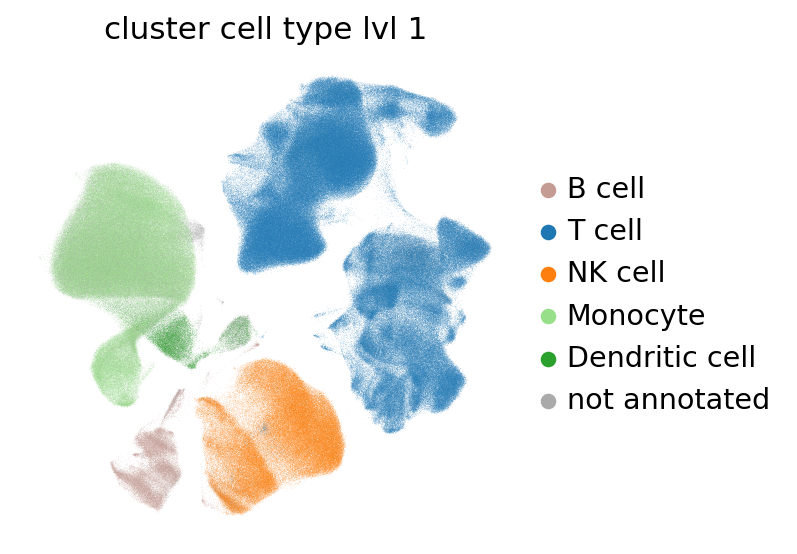

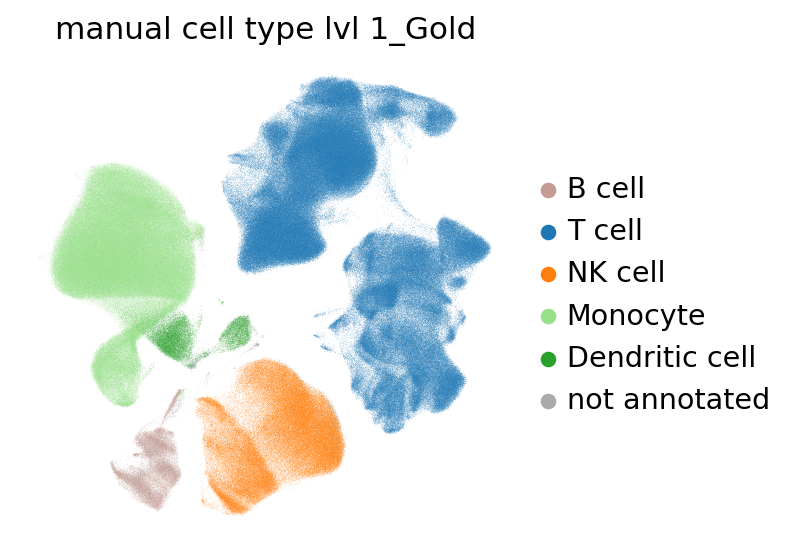

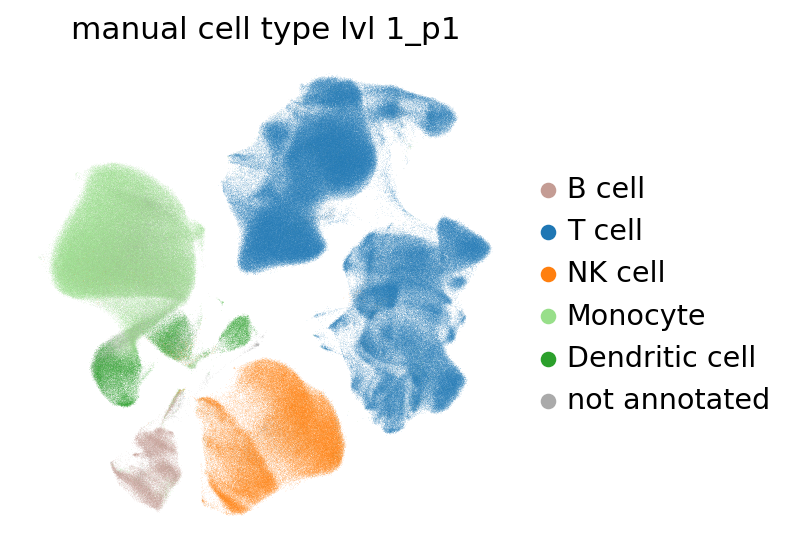

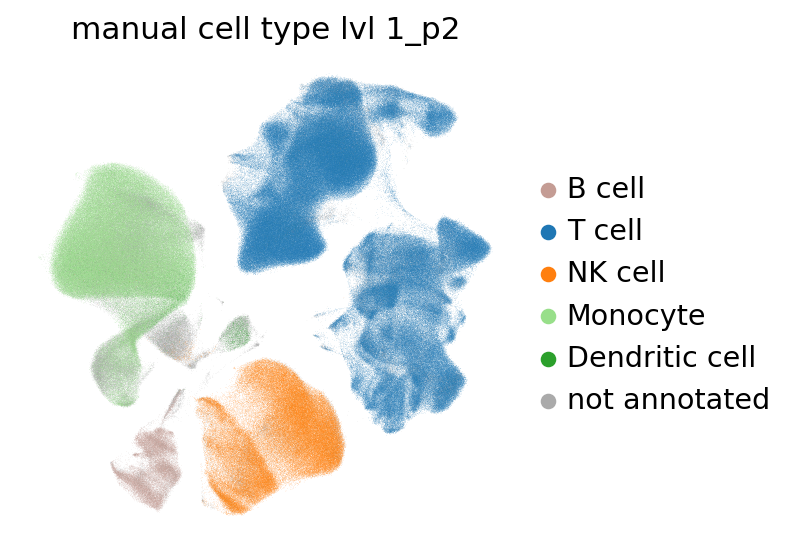

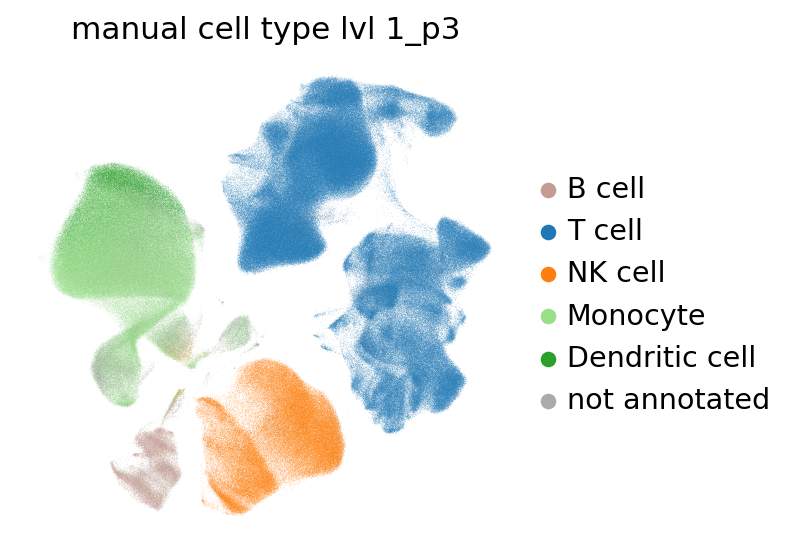

...

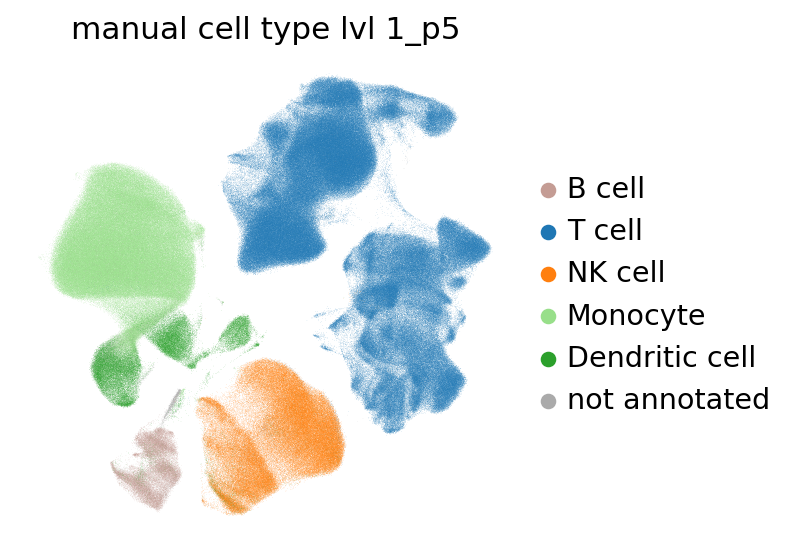

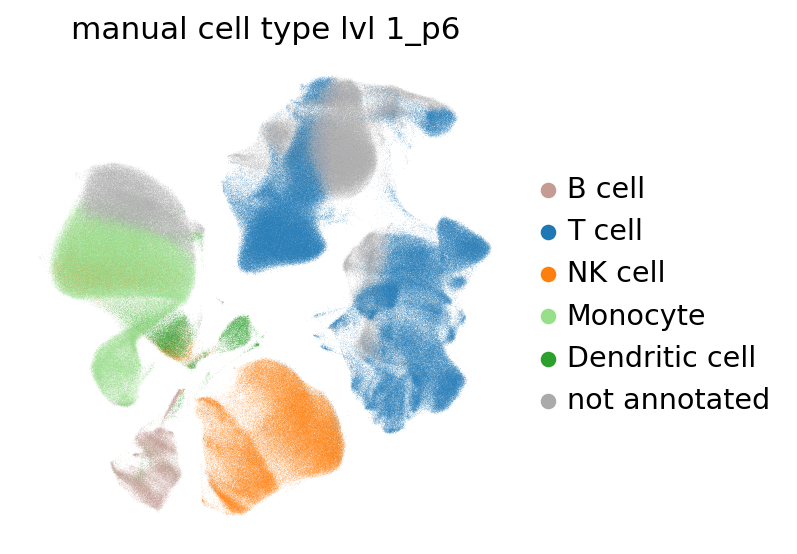

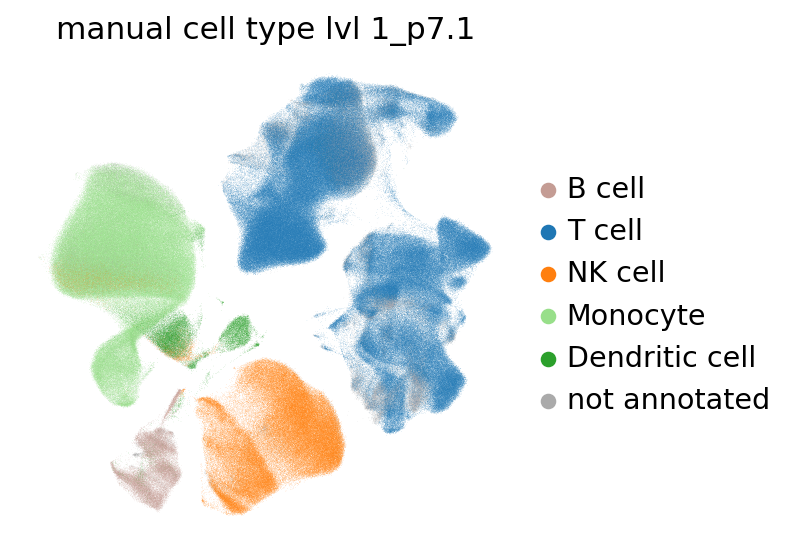

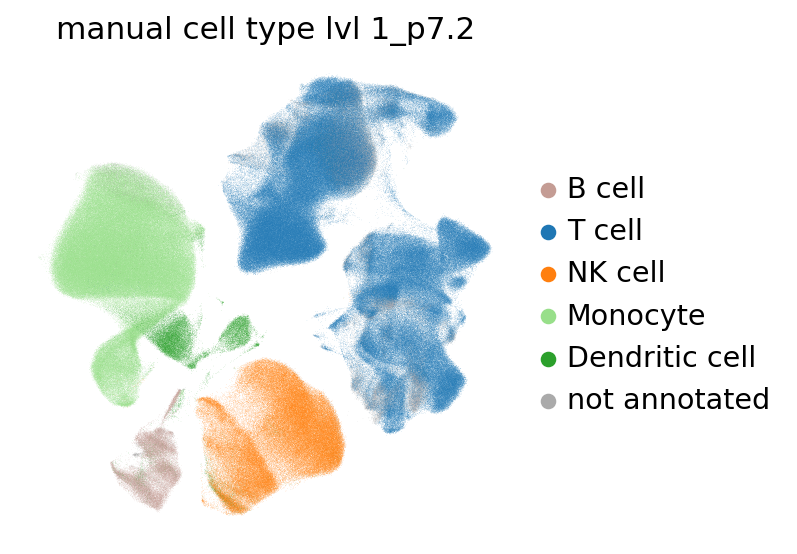

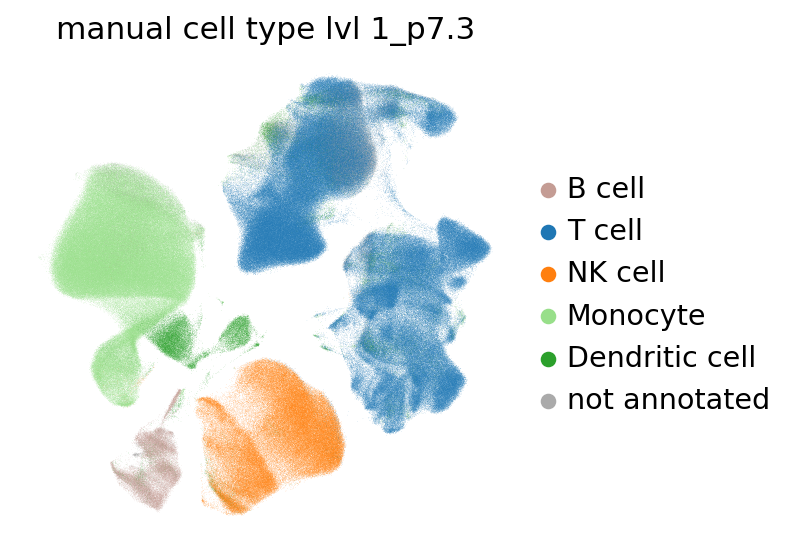

In [62]:
for key in anno_keys:
    adata_sub2.obs[key] = adata_sub2.obs[key].astype('category')
    adata_sub2.obs[key] = adata_sub2.obs[key].cat.reorder_categories(
        ['B cell','T cell', 'NK cell',  'Monocyte', 'Dendritic cell', 'not annotated'])
    adata_sub2.uns[f'{key}_colors'] = adata_sub2.uns['consensus label lvl 1_colors']
    sc.pl.umap(adata_sub2, 
           color=key,  ncols=1, frameon=False, 
           save=f'{today}_{key}.png'
          )
    

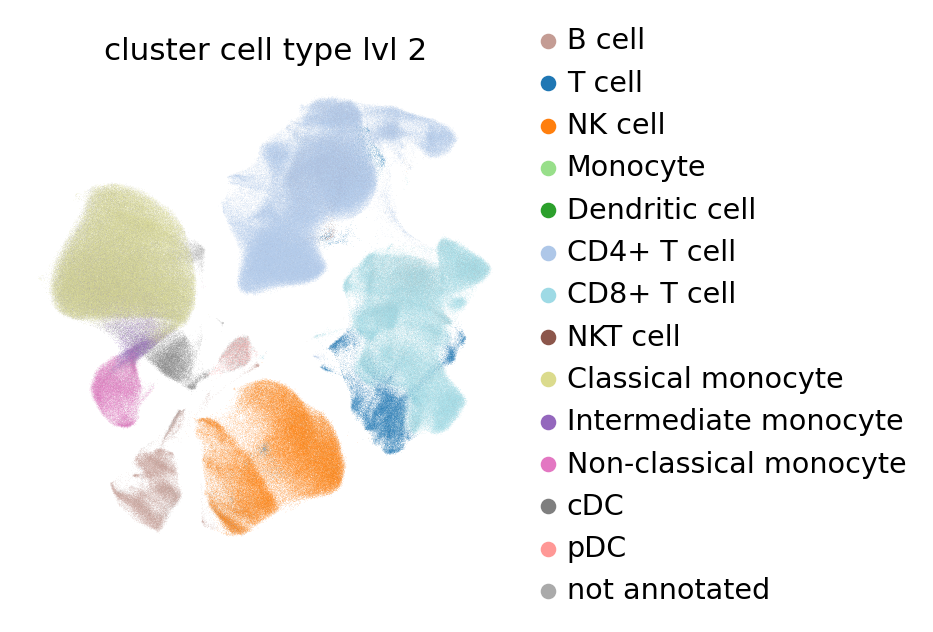

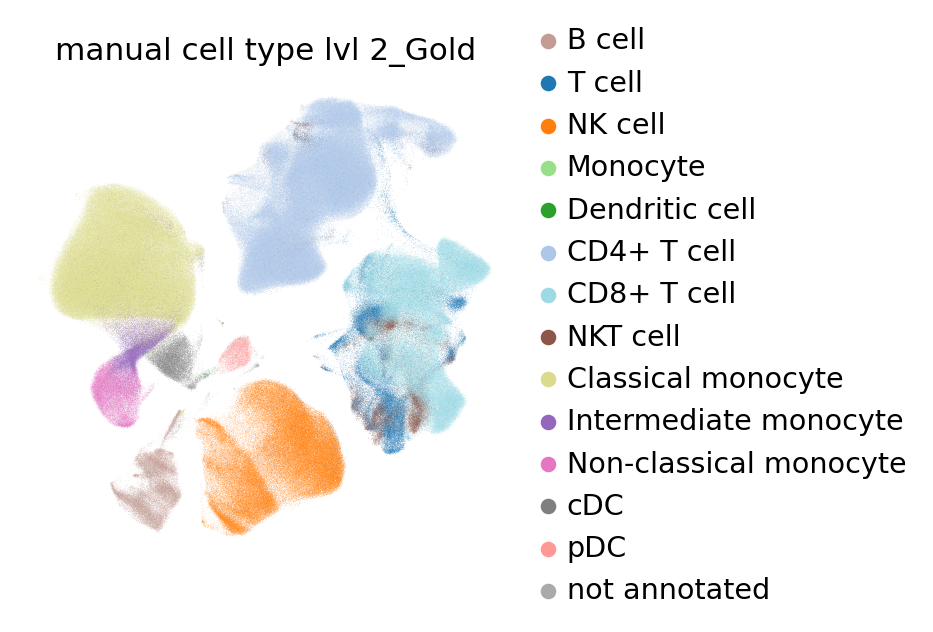

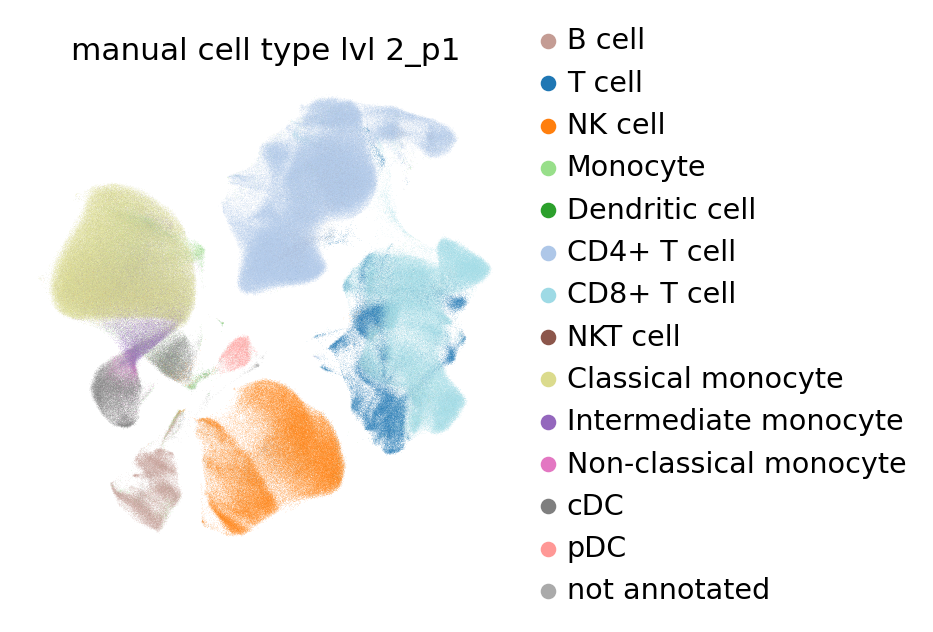

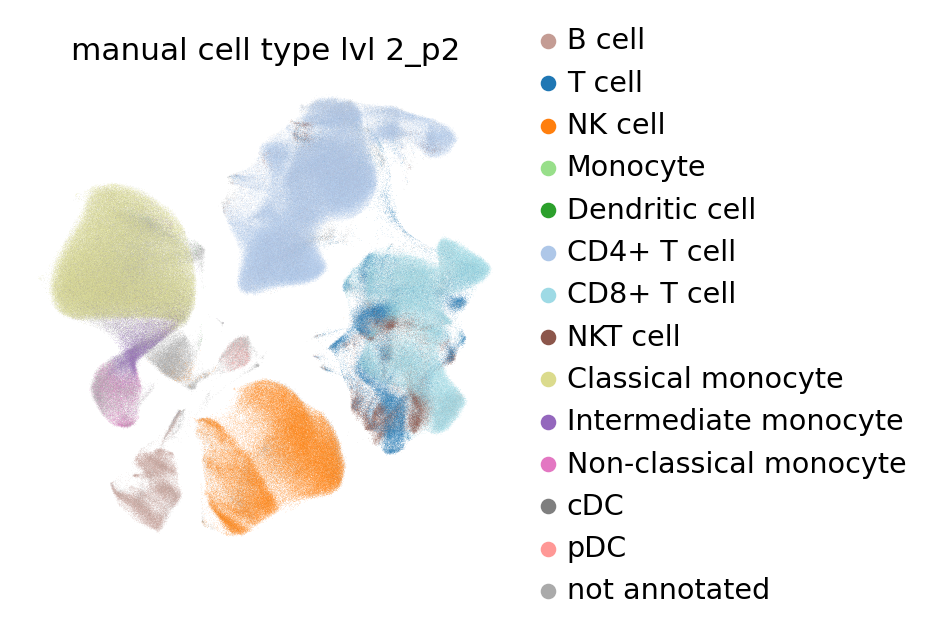

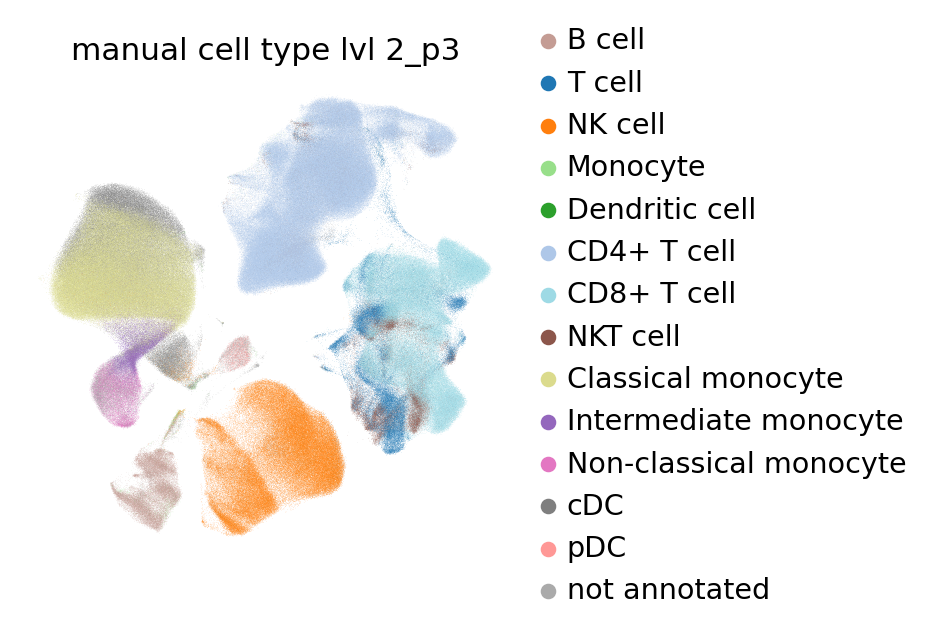

...

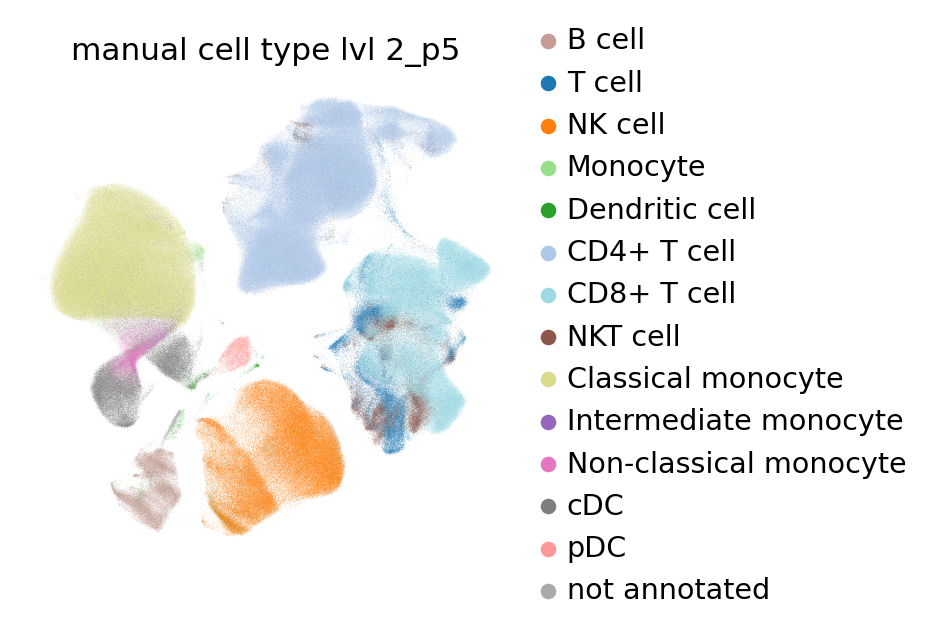

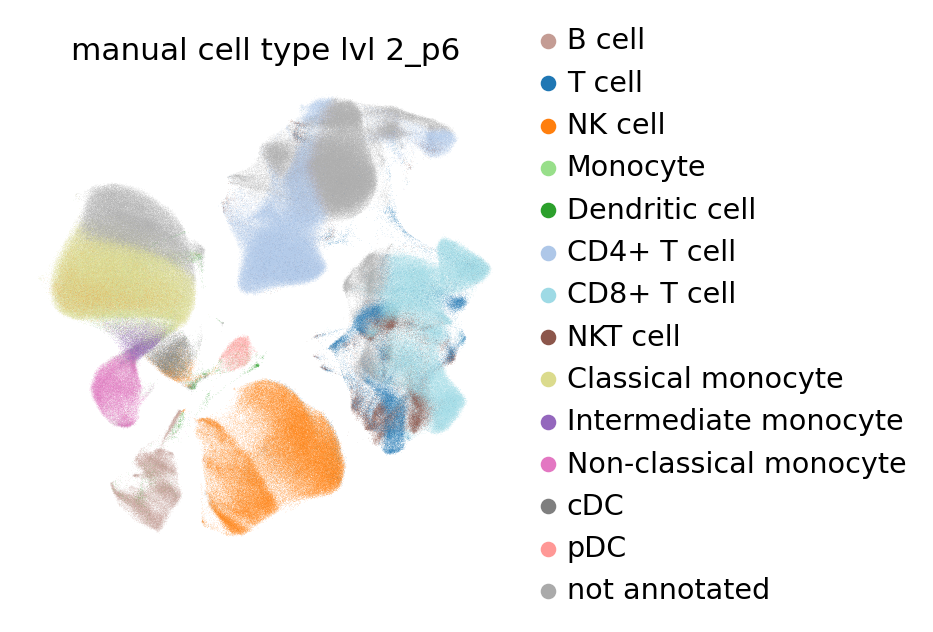

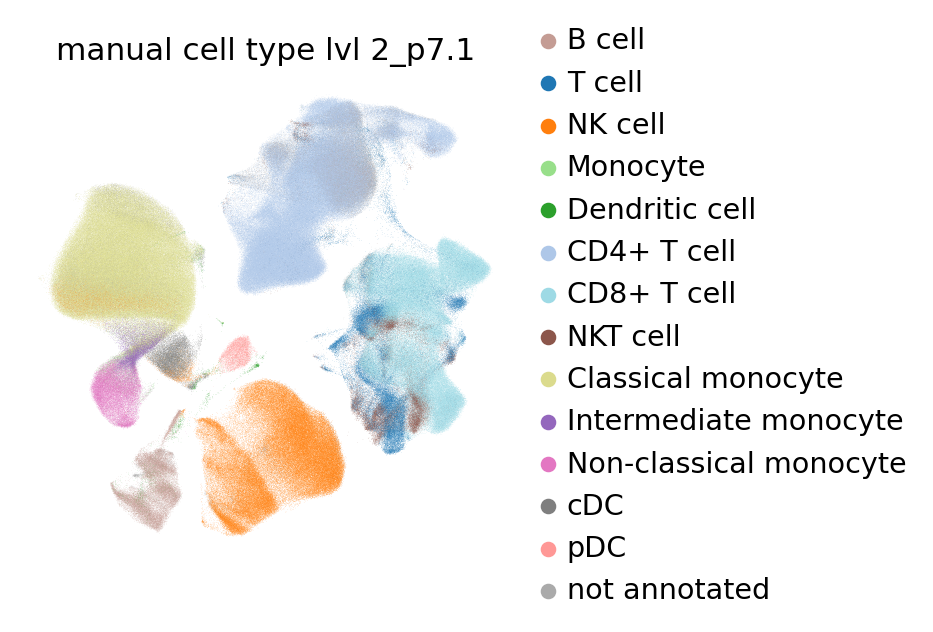

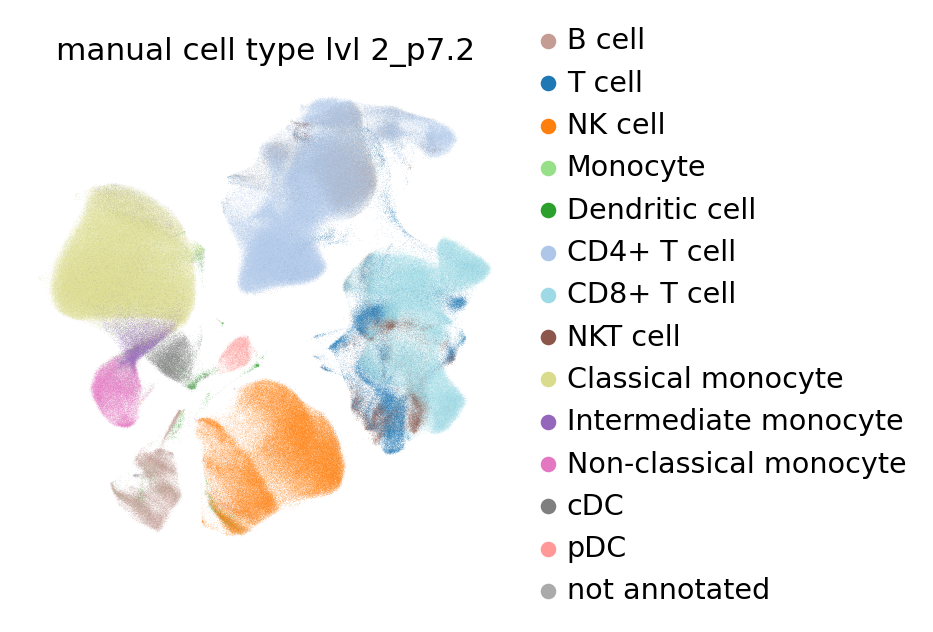

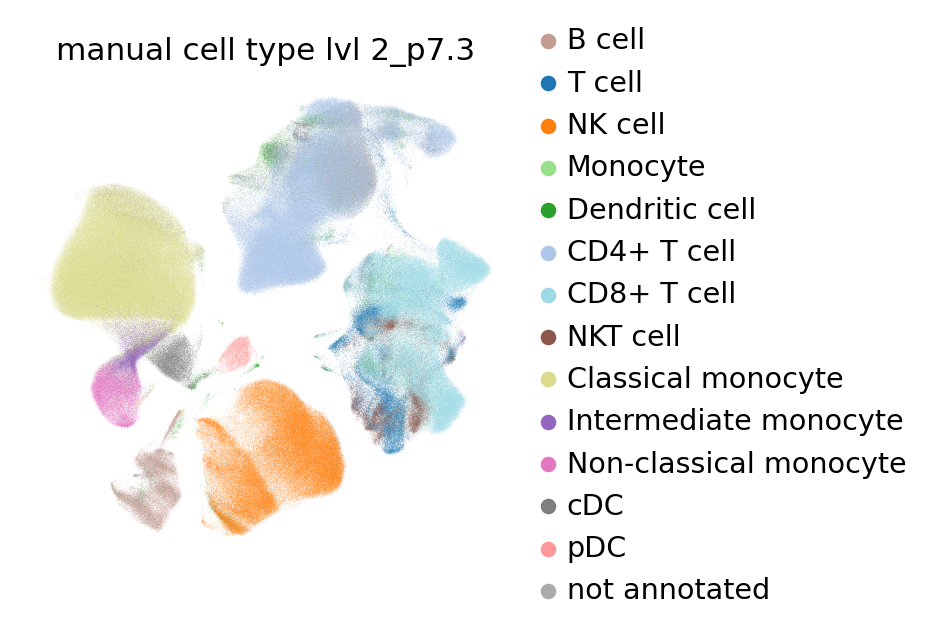

In [69]:
for key in anno_keys2:
    adata_sub2.obs[key] = adata_sub2.obs[key].astype('category')
    adata_sub2.obs[key] = adata_sub2.obs[key].cat.rename_categories({'NK T cell': 'NKT cell'})
    missing_cat = np.setdiff1d(['B cell',
 'T cell',
 'NK cell',  'Monocyte', 'Dendritic cell', 
         'CD4+ T cell', 'CD8+ T cell', 'NKT cell', 
         'Classical monocyte', 'Intermediate monocyte','Non-classical monocyte', 
         'cDC', 'pDC',  'not annotated'],  adata_sub2.obs[key].cat.categories)
    adata_sub2.obs[key] = adata_sub2.obs[key].cat.add_categories(list(missing_cat))
    adata_sub2.obs[key] = adata_sub2.obs[key].cat.reorder_categories(
        ['B cell','T cell', 'NK cell',  'Monocyte', 'Dendritic cell', 
         'CD4+ T cell', 'CD8+ T cell', 'NKT cell', 
         'Classical monocyte', 'Intermediate monocyte','Non-classical monocyte', 
         'cDC', 'pDC',  'not annotated'])
    adata_sub2.uns[f'{key}_colors'] = adata_sub2.uns['consensus label lvl 2_colors']
    sc.pl.umap(adata_sub2, 
           color=key,  ncols=1, frameon=False, 
           save=f'{today}_{key}.png'
          )

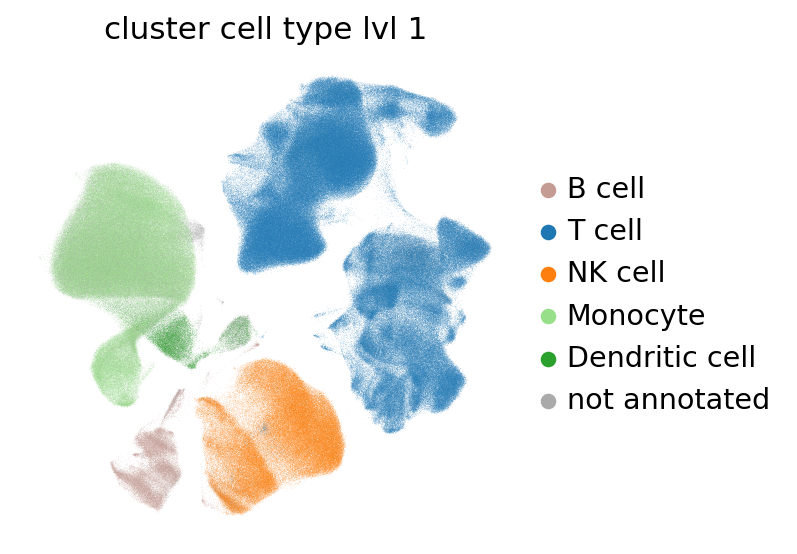

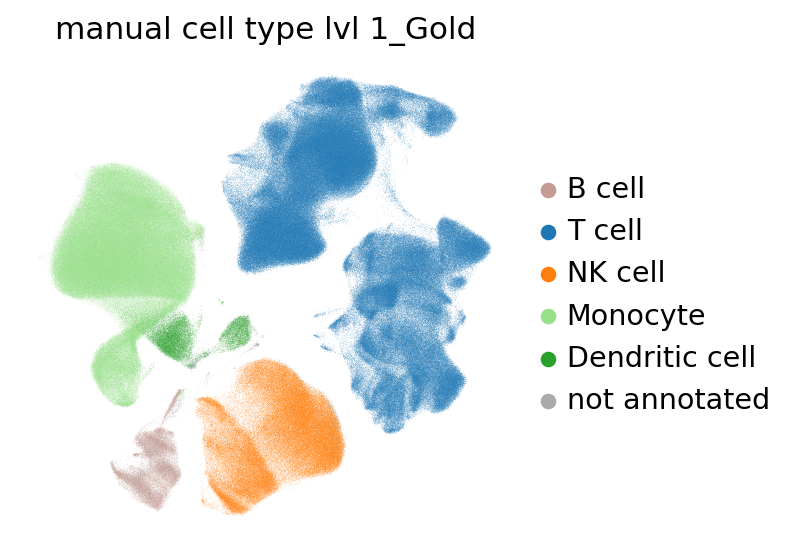

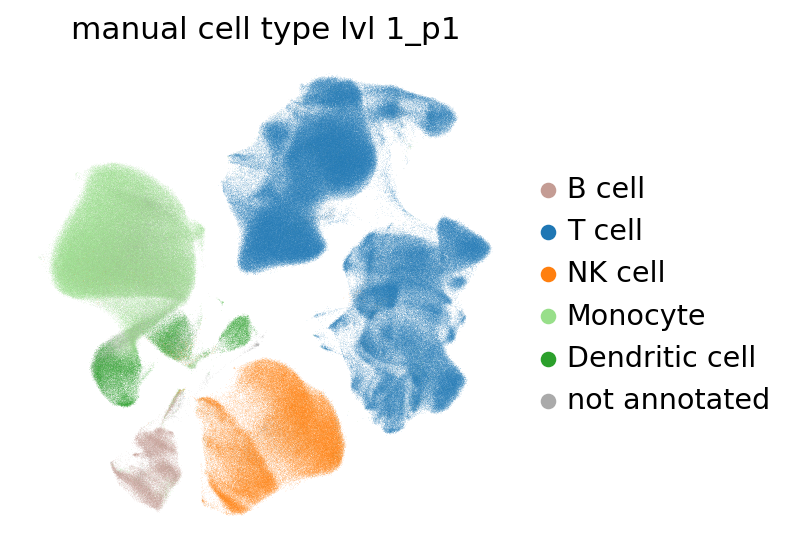

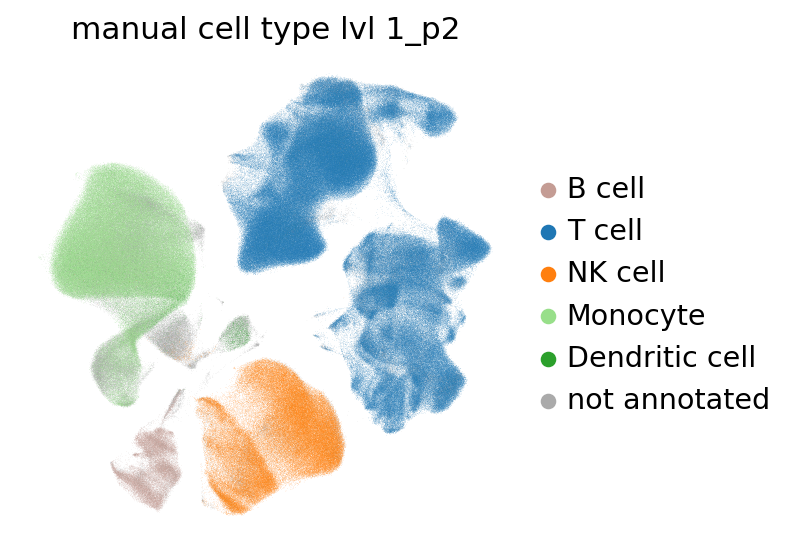

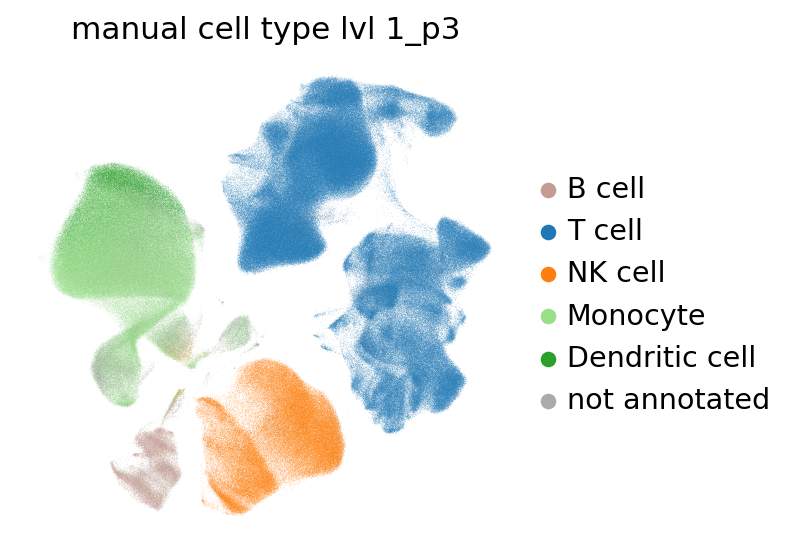

...

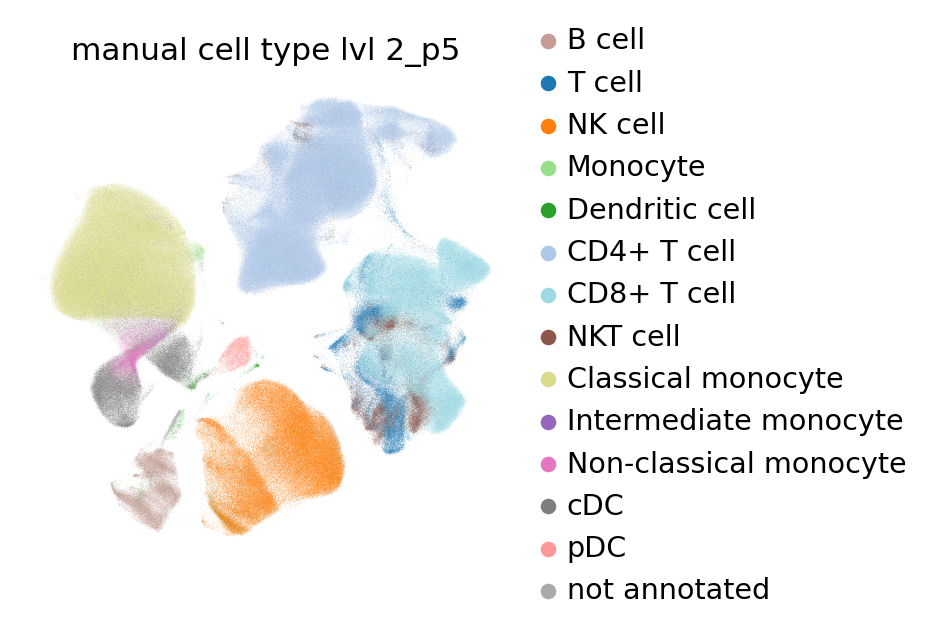

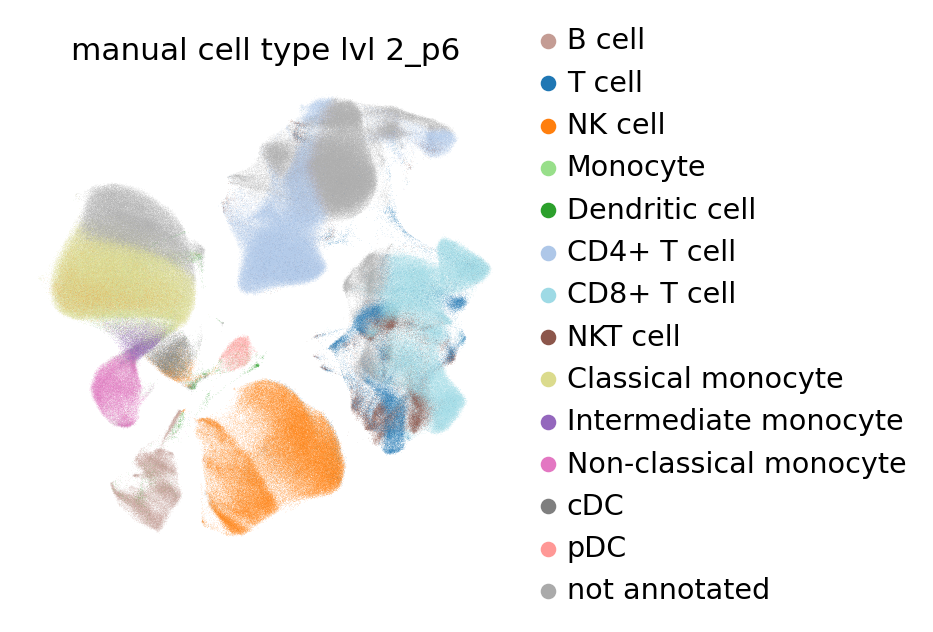

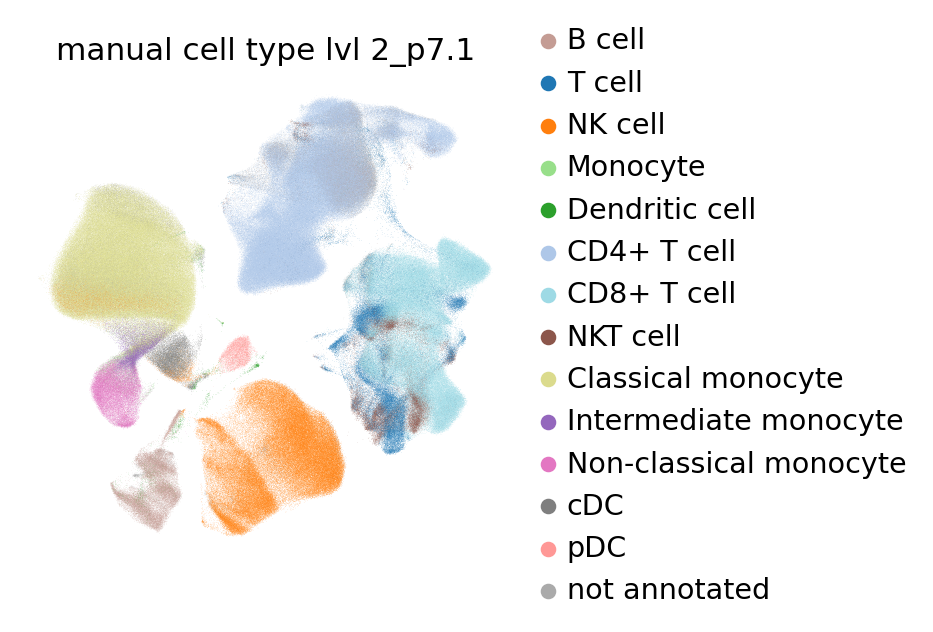

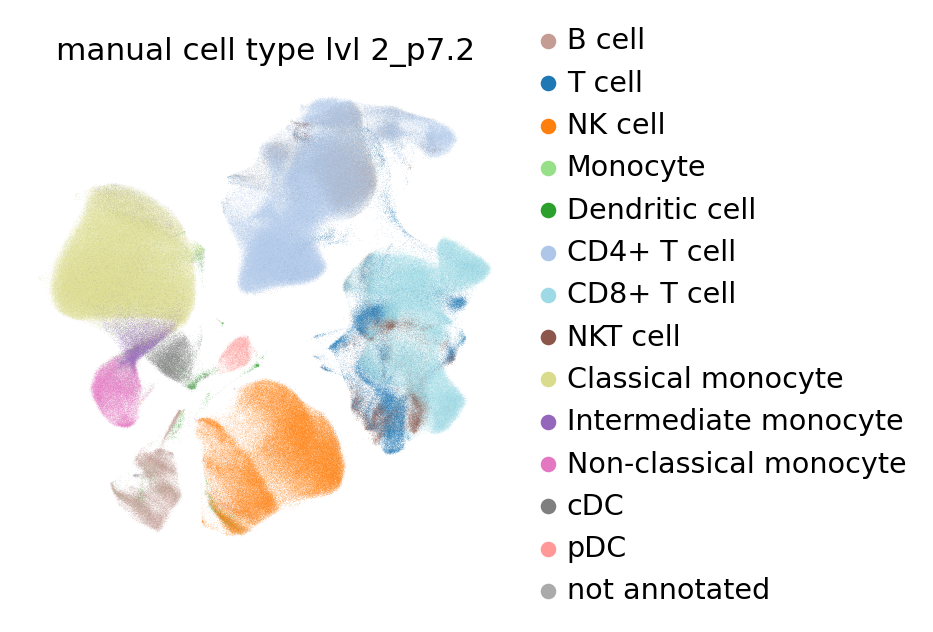

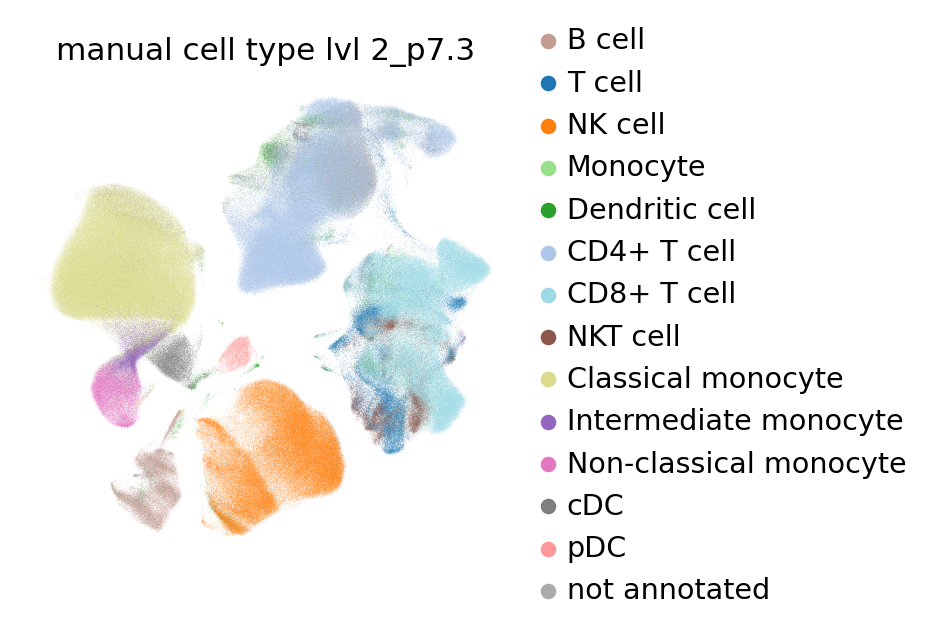

In [70]:
for key in anno_keys:
    #adata_sub2.uns[f'{key}_colors'] = adata_sub2.uns['consensus label lvl 1_colors']
    sc.pl.umap(adata_sub2, 
           color=key,  ncols=1, frameon=False, 
           save=f'{today}_{key}.pdf'
          )
for key in anno_keys2:
    #adata_sub2.uns[f'{key}_colors'] = adata_sub2.uns['consensus label lvl 2_colors']
    sc.pl.umap(adata_sub2, 
           color=key,  ncols=1, frameon=False, 
           save=f'{today}_{key}.pdf'
          )

## Heatmap for markers

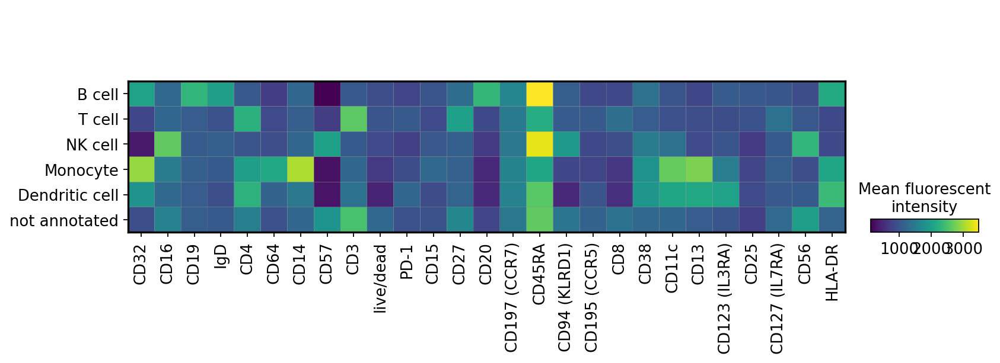

In [71]:
sc.pl.matrixplot(adata_sub2, groupby='consensus label lvl 1', 
                 var_names=adata_sub2.var_names, 
                 colorbar_title = 'Mean fluorescent\nintensity',
                 save=f"{today}_consensus_lvl1_MFI.pdf"
                )

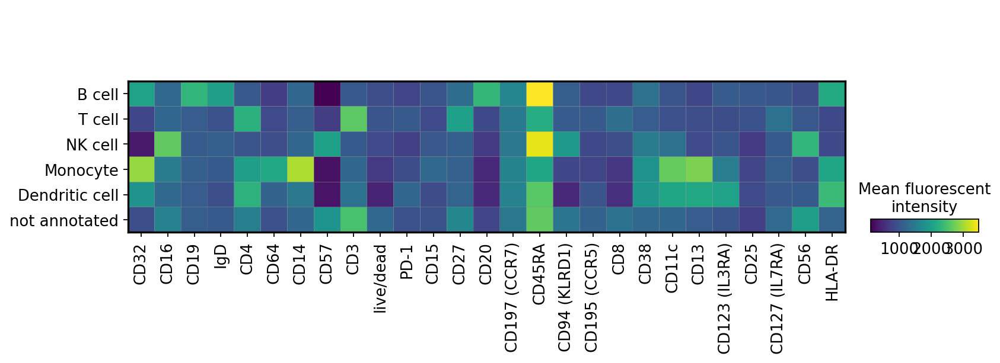

In [72]:
sc.pl.matrixplot(adata_sub2, groupby='consensus label lvl 1', 
                 var_names=adata_sub2.var_names, 
                 colorbar_title = 'Mean fluorescent\nintensity',
                 save=f"{today}_consensus_lv12_MFI.png"
                )

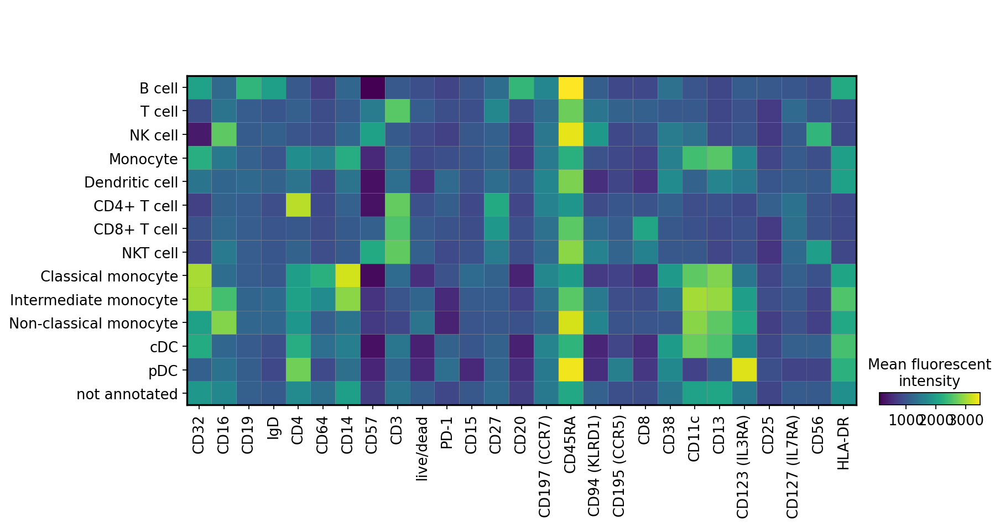

In [73]:
sc.pl.matrixplot(adata_sub2, groupby='consensus label lvl 2', 
                 var_names=adata_sub2.var_names, 
                 colorbar_title = 'Mean fluorescent\nintensity',
                 save=f"{today}_consensus_lvl2_MFI.pdf"
                )

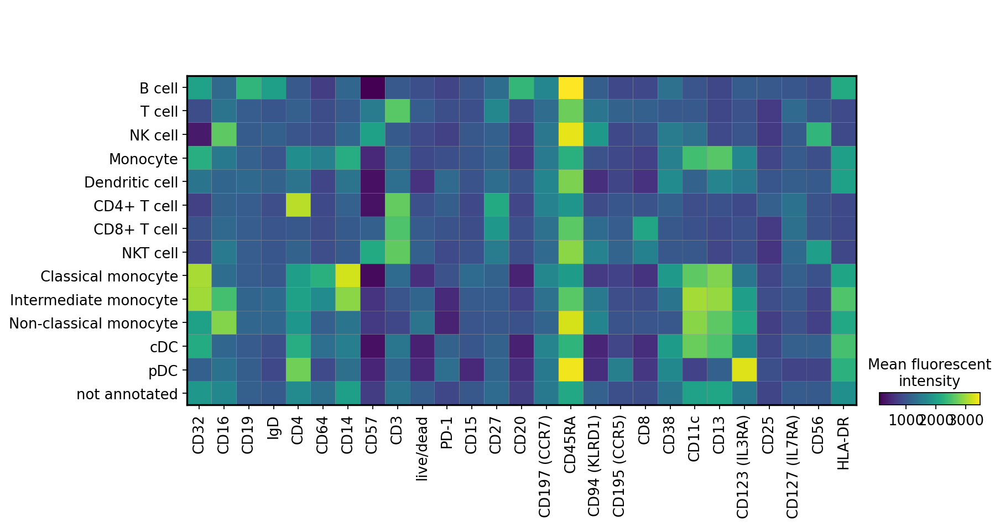

In [74]:
sc.pl.matrixplot(adata_sub2, groupby='consensus label lvl 2', 
                 var_names=adata_sub2.var_names, 
                 colorbar_title = 'Mean fluorescent\nintensity',
                 save=f"{today}_consensus_lvl2_MFI.png"
                )